# DCGAN on celebA dataset final project
This notebook is where I will be doing my experiments on celebA using DC GANs with two different activations and many different learning rates to get the best results. Along the way, I will be trying my best to have effective logging and visualization in order to show the progress of the results and training better. 

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
import torchvision.datasets as datasets
import torchvision.utils as utils
from torchmetrics.image.inception import InceptionScore
from torchmetrics.image.fid import FrechetInceptionDistance
import matplotlib.pyplot as plt
import numpy as np
from collections import defaultdict
import os

cfg = {
    "dataset": "celeba",
    "image_size": 64,
    "nc": 3,
    "nz": 100,
    "ngf": 64,
    "ndf": 64,
    "lr": 0.0002,
    "beta1": 0.5,
    "print_every":25,
    "batch_size": 64,
    "num_epochs": 25,
    "sample_every": 5,
    "sample_dir": "celeba_samples",
    "device": "cuda" if torch.cuda.is_available() else "cpu"
}

os.makedirs(cfg["sample_dir"], exist_ok=True)

device = torch.device(cfg["device"])
print(f"Using device: {device}")

Using device: cuda


In [ ]:
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision import datasets
from torch.utils.data import Subset

import os

transform = transforms.Compose([
   transforms.Resize(cfg["image_size"]),
   transforms.CenterCrop(cfg["image_size"]),
   transforms.ToTensor(),
   transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

celeba_full = datasets.CelebA(
   root='./data',
   split='train',
   transform=transform,
   download=True
)

celeba_dataset = Subset(celeba_full, range(50000))

dataloader = DataLoader(
   celeba_dataset,
   batch_size=cfg["batch_size"],
   shuffle=True,
   num_workers=0,
   pin_memory=True,
   drop_last=True
)



In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Generator(nn.Module):
    def __init__(self, nz, ngf, nc, activation='relu'):
        super(Generator, self).__init__()
        self.activation = activation

        if activation == 'relu':
            act_fn = nn.ReLU(True)
        elif activation == 'elu':
            act_fn = nn.ELU(True)

        self.main = nn.Sequential(

            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            act_fn,
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            act_fn,
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            act_fn,

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            act_fn,
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()

        )

    def forward(self, input):
        return self.main(input)

class Discriminator(nn.Module):
    def __init__(self, nc, ndf):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1, 1).squeeze(1)

In [ ]:
class EMA: #maybe not use 
    def __init__(self, model, decay=0.999):
        self.model = model
        self.decay = decay
        self.shadow = {}
        self.backup = {}
        for name, param in model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()

    def update(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = self.decay * self.shadow[name] + (1 - self.decay) * param.data

    def apply_shadow(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.backup[name] = param.data.clone()
                param.data = self.shadow[name]

    def restore(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                param.data = self.backup[name]

Batch shape: torch.Size([64, 3, 64, 64])
Value range: [-1.000, 1.000]


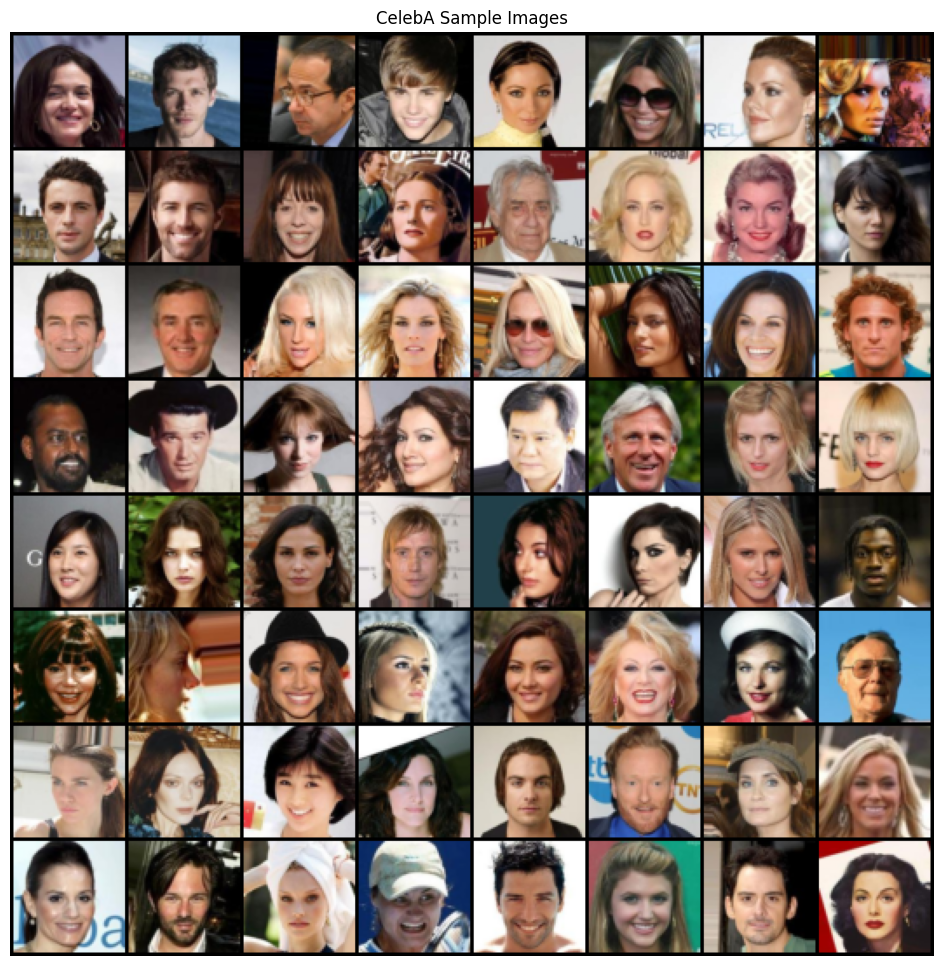

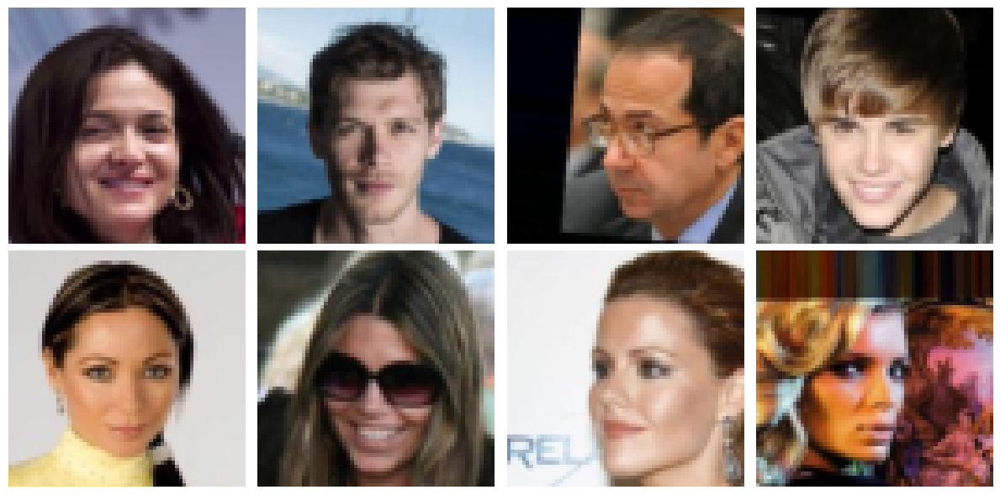

In [ ]:
import matplotlib.pyplot as plt
import torchvision.utils as utils
import numpy as np

sample_batch = next(iter(dataloader))
images, labels = sample_batch

print(f"Batch shape: {images.shape}")
print(f"Value range: [{images.min():.3f}, {images.max():.3f}]")

plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("CelebA Sample Images")
grid = utils.make_grid(images[:64], nrow=8, padding=2, normalize=True)
plt.imshow(grid.permute(1, 2, 0))
plt.show()
#for example
fig, axes = plt.subplots(2, 4, figsize=(12, 6))
for i in range(8):
    row = i // 4
    col = i % 4

    img = images[i].permute(1, 2, 0)
    img = (img + 1) / 2
    img = torch.clamp(img, 0, 1)

    axes[row, col].imshow(img)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

Starting training...
Total batches per epoch: 781
Device: cuda


Epoch 1/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   1/25 | G_loss: 5.1801 | D_loss: 1.0577 | Time: 66.5s


Epoch 2/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   2/25 | G_loss: 2.6141 | D_loss: 1.1095 | Time: 132.6s


Epoch 3/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   3/25 | G_loss: 2.3160 | D_loss: 1.0844 | Time: 198.4s


Epoch 4/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   4/25 | G_loss: 2.3833 | D_loss: 1.0264 | Time: 264.1s


Epoch 5/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   5/25 | G_loss: 2.5412 | D_loss: 0.9582 | Time: 329.9s
Generating samples for epoch 5...


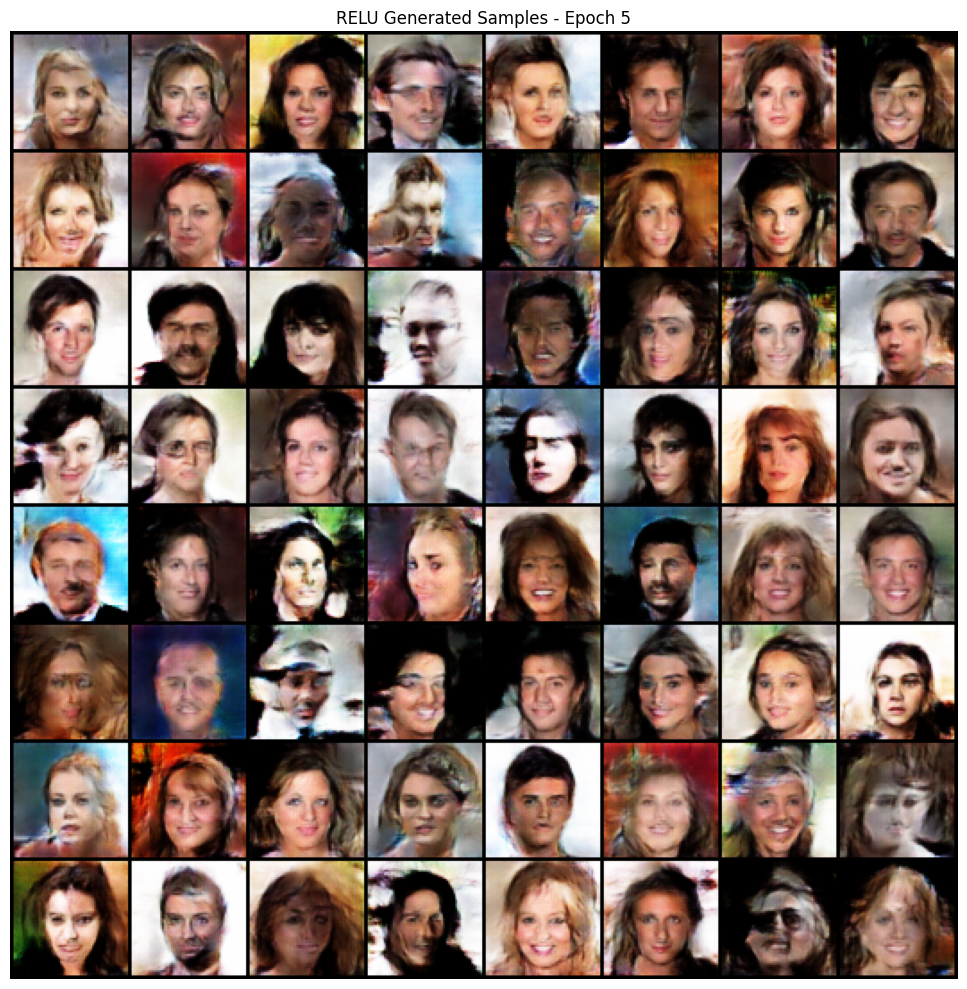

Epoch 6/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   6/25 | G_loss: 2.6427 | D_loss: 0.9301 | Time: 397.9s


Epoch 7/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   7/25 | G_loss: 2.7396 | D_loss: 0.9032 | Time: 465.0s


Epoch 8/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   8/25 | G_loss: 2.8333 | D_loss: 0.8744 | Time: 532.1s


Epoch 9/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   9/25 | G_loss: 2.9578 | D_loss: 0.8438 | Time: 599.3s


Epoch 10/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  10/25 | G_loss: 3.0879 | D_loss: 0.8007 | Time: 666.4s
Generating samples for epoch 10...


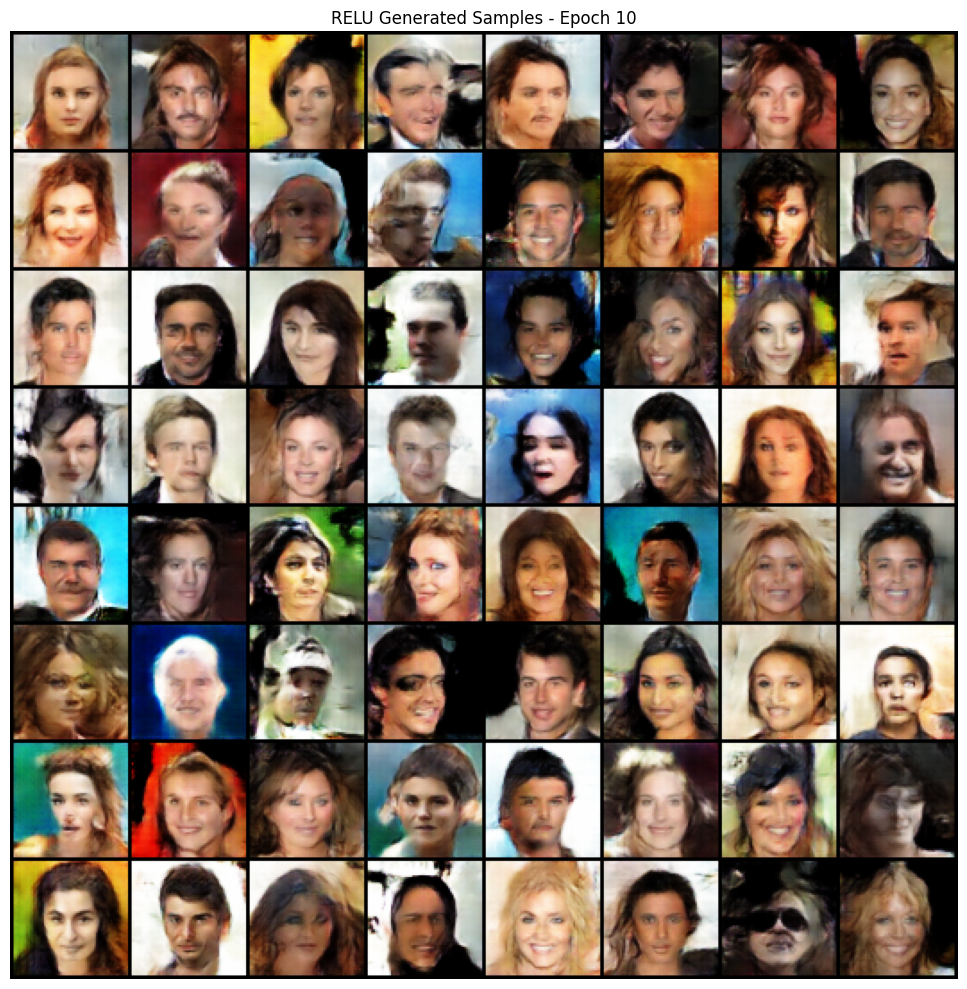

Checkpoint saved: checkpoints/relu_checkpoint_epoch_010.pth


Epoch 11/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  11/25 | G_loss: 3.2139 | D_loss: 0.7678 | Time: 734.8s


Epoch 12/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  12/25 | G_loss: 3.3638 | D_loss: 0.7318 | Time: 802.2s


Epoch 13/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  13/25 | G_loss: 3.5563 | D_loss: 0.6792 | Time: 869.4s


Epoch 14/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  14/25 | G_loss: 3.6733 | D_loss: 0.6633 | Time: 937.3s


Epoch 15/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  15/25 | G_loss: 3.8690 | D_loss: 0.6191 | Time: 1004.7s
Generating samples for epoch 15...


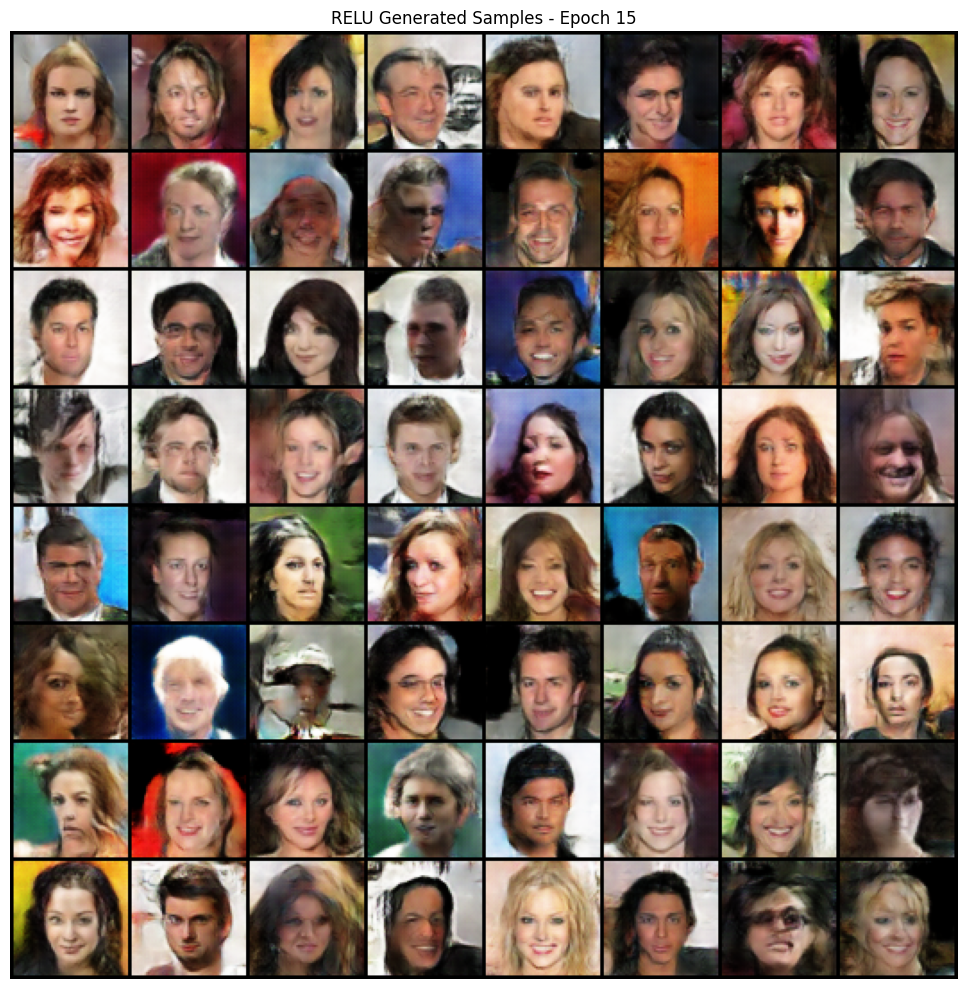

Epoch 16/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  16/25 | G_loss: 4.0031 | D_loss: 0.6042 | Time: 1072.2s


Epoch 17/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  17/25 | G_loss: 4.1284 | D_loss: 0.5689 | Time: 1139.3s


Epoch 18/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  18/25 | G_loss: 4.2670 | D_loss: 0.5510 | Time: 1206.5s


Epoch 19/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  19/25 | G_loss: 4.3714 | D_loss: 0.5546 | Time: 1273.5s


Epoch 20/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  20/25 | G_loss: 4.3023 | D_loss: 0.5857 | Time: 1340.7s
Generating samples for epoch 20...


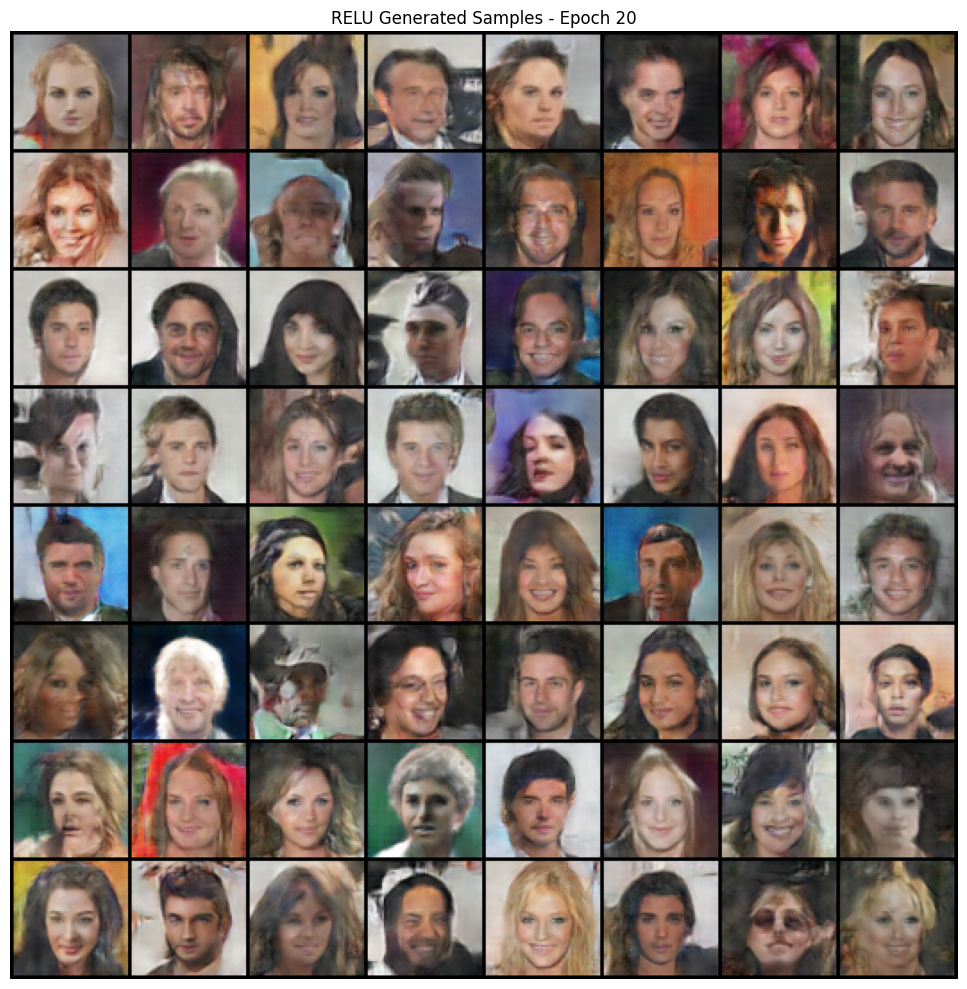

Checkpoint saved: checkpoints/relu_checkpoint_epoch_020.pth


Epoch 21/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  21/25 | G_loss: 4.3019 | D_loss: 0.5772 | Time: 1408.7s


Epoch 22/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  22/25 | G_loss: 4.2847 | D_loss: 0.5714 | Time: 1475.7s


Epoch 23/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  23/25 | G_loss: 4.3550 | D_loss: 0.5485 | Time: 1542.7s


Epoch 24/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  24/25 | G_loss: 4.3863 | D_loss: 0.5455 | Time: 1609.8s


Epoch 25/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  25/25 | G_loss: 4.4517 | D_loss: 0.5309 | Time: 1676.7s
Generating samples for epoch 25...


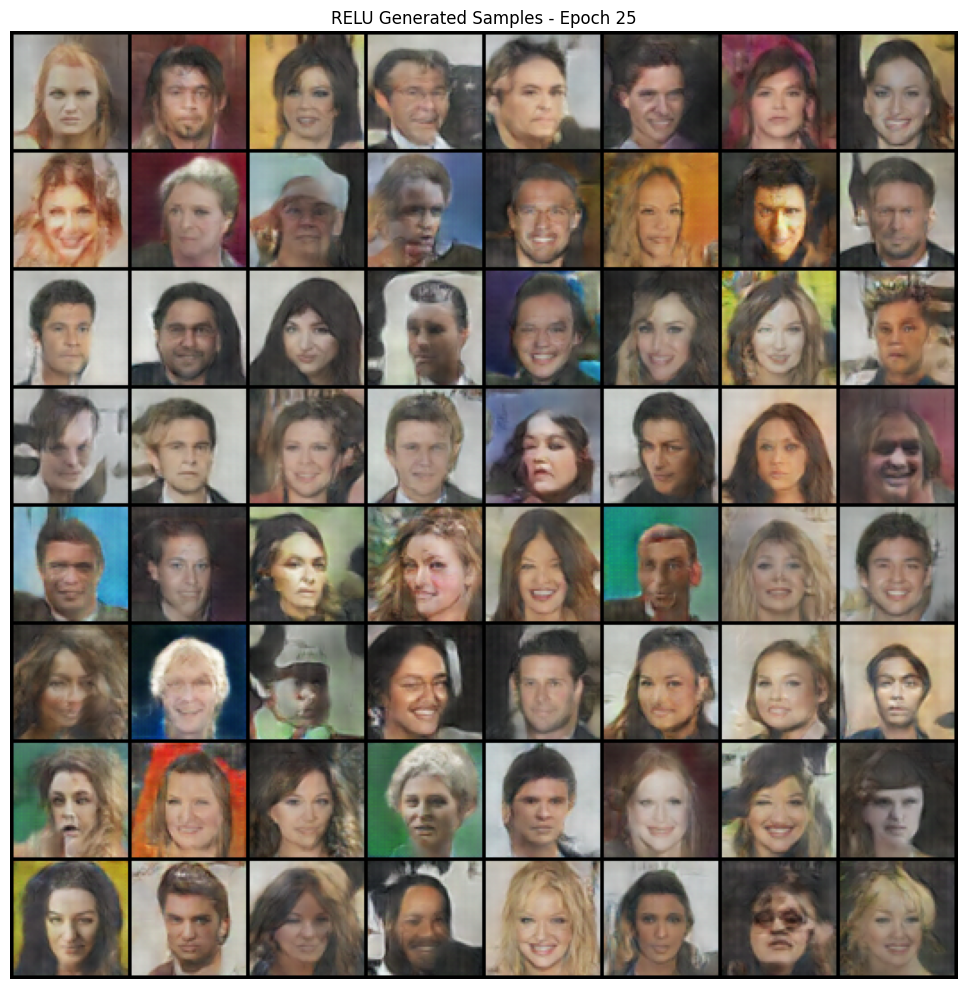


ReLU training completed in 1677.6 seconds (28.0 minutes)
Training completed!


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import time
from collections import defaultdict
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from pathlib import Path

cfg = {

    "image_size": 64,
    "nc": 3,
    "subset_size": 50000,

    # hyperparameters
    "nz": 100,
    "ngf": 64,
    "ndf": 64,

    "batch_size": 64,
    "num_epochs": 25,
    "lr_g": 0.0002,
    "lr_d": 0.0003,
    "beta1": 0.0,
    "beta2": 0.9,

    "label_smoothing": 0.1,
    "noise_std": 0.1,

    "sample_every": 5,
    "print_every": 50,

    "device": "cuda" if torch.cuda.is_available() else "cpu",
    "num_workers": 4,
    "sample_dir": "celeba_samples"
}

# to turn in 
def save_samples(epoch, generator, model_name, fixed_noise, cfg):
   generator.eval()
   with torch.no_grad():
       fake_samples = generator(fixed_noise)
       grid = utils.make_grid(fake_samples, nrow=8, padding=2, normalize=True)


       filename = f"{cfg['sample_dir']}/{model_name}_epoch_{epoch:03d}.png"
       utils.save_image(grid, filename)


       plt.figure(figsize=(10, 10))
       plt.imshow(grid.cpu().permute(1, 2, 0))
       plt.title(f"{model_name.upper()} Generated Samples - Epoch {epoch}")
       plt.axis('off')
       plt.tight_layout()
       plt.show()

   generator.train()
   return filename

device = torch.device(cfg["device"]) 

G = Generator(cfg["nz"], cfg["ngf"], 3, activation='relu').to(device)
D = Discriminator(3, cfg["ndf"]).to(device)

G.apply(weights_init)
D.apply(weights_init)

optimizerG = optim.Adam(G.parameters(), lr=cfg["lr_g"], betas=(cfg["beta1"], cfg["beta2"])) #change
optimizerD = optim.Adam(D.parameters(), lr=cfg["lr_d"], betas=(cfg["beta1"], cfg["beta2"])) #change
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, cfg["nz"], 1, 1, device=device)
ema_G = EMA(G, decay=0.999)

history = {
   'G_loss': [],
   'D_loss': [],
   'epochs': []
}

Path(cfg["sample_dir"]).mkdir(exist_ok=True)
Path("checkpoints").mkdir(exist_ok=True)

print("Starting training...")
print(f"Total batches per epoch: {len(dataloader)}")
print(f"Device: {device}")

start_time = time.time()

for epoch in range(cfg["num_epochs"]):
   G.train()
   D.train()

   G_losses = []
   D_losses = []

   pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{cfg['num_epochs']}", leave=False)

   for i, (data, _) in enumerate(pbar):
       D.zero_grad()
       real_data = data.to(device)
       batch_size = real_data.size(0)

       # REal
       label = torch.full((batch_size,), 1., dtype=torch.float, device=device)
       output = D(real_data)
       errD_real = criterion(output, label)
       errD_real.backward()

       # Fake
       noise = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
       fake = G(noise)
       label.fill_(0.)
       output = D(fake.detach())
       errD_fake = criterion(output, label)
       errD_fake.backward()

       errD = errD_real + errD_fake
       optimizerD.step()
       G.zero_grad()
       label.fill_(1.)
       output = D(fake)
       errG = criterion(output, label)
       errG.backward()
       optimizerG.step()
       ema_G.update()

       G_losses.append(errG.item())


       D_losses.append(errD.item())

       pbar.set_postfix({
           'G_loss': f'{errG.item():.4f}',
           'D_loss': f'{errD.item():.4f}'
       })

   epoch_time = time.time() - start_time
   avg_G_loss = np.mean(G_losses)
   avg_D_loss = np.mean(D_losses)
   history['epochs'].append(epoch + 1)
   history['G_loss'].append(avg_G_loss)
   history['D_loss'].append(avg_D_loss)

   elapsed = time.time() - start_time
   print(f"Epoch {epoch+1:3d}/{cfg['num_epochs']} | G_loss: {avg_G_loss:.4f} | D_loss: {avg_D_loss:.4f} | Time: {elapsed:.1f}s")

   if (epoch + 1) % cfg["sample_every"] == 0:
       print(f"Generating samples for epoch {epoch+1}...")
       save_samples(epoch + 1, G, "relu", fixed_noise, cfg)

   if (epoch + 1) % 10 == 0:
       ema_G.apply_shadow()
       checkpoint = {
           'epoch': epoch + 1,
           'G_state_dict': G.state_dict(),
           'D_state_dict': D.state_dict(),
           'opt_G_state_dict': optimizerG.state_dict(),
           'opt_D_state_dict': optimizerD.state_dict(),
           'ema_shadow': ema_G.shadow,
           'history': history,
           'config': cfg
       }
       torch.save(checkpoint, f"checkpoints/relu_checkpoint_epoch_{epoch+1:03d}.pth")
       ema_G.restore()
       print(f"Checkpoint saved: checkpoints/relu_checkpoint_epoch_{epoch+1:03d}.pth")

total_time = time.time() - start_time
print(f"\nReLU training completed in {total_time:.1f} seconds ({total_time/60:.1f} minutes)")

ema_G.apply_shadow()
final_checkpoint = {
   'epoch': cfg["num_epochs"],
   'G_state_dict': G.state_dict(),
   'D_state_dict': D.state_dict(),
   'ema_shadow': ema_G.shadow,
   'history': history,
   'config': cfg,
   'timestamp': time.strftime("%Y-%m-%d %H:%M:%S"),
   'total_training_time': total_time
}
torch.save(final_checkpoint, "checkpoints/relu_dcgan_celeba_final.pth")
ema_G.restore()

print("Training complete")

In [ ]:
def evaluate_inception_score(generator, ema_generator, model_name):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    generator = ema_generator.shadow
    generator.eval()

    inception_model = inception_v3(pretrained=True, transform_input=False).to(device)
    inception_model.eval()

    def get_pred(x):
        x = F.interpolate(x, size=(299, 299), mode='bilinear', align_corners=False)
        with torch.no_grad():
            x = inception_model(x)
            x = F.softmax(x, dim=1).cpu().numpy()
        return x

    n_samples = 5000
    batch_size = 64
    preds = np.zeros((n_samples, 1000))

    with torch.no_grad():
        for i in range(0, n_samples, batch_size):
            current_batch_size = min(batch_size, n_samples - i)
            noise = torch.randn(current_batch_size, cfg["nz"], 1, 1, device=device)
            fake_samples = ((generator(noise) + 1) / 2 * 255).clamp(0, 255).to(torch.uint8)
            preds[i:i+current_batch_size] = get_pred(fake_samples)

    splits = 10
    split_scores = []
    for k in range(splits):
        part = preds[k * (n_samples // splits): (k+1) * (n_samples // splits), :]
        py = np.mean(part, axis=0)
        scores = [entropy(pyx, py) for pyx in part]
        split_scores.append(np.exp(np.mean(scores)))

    inception_score = np.mean(split_scores)
    inception_std = np.std(split_scores)

    print(f"{model_name} Inception Score: {inception_score:.3f} ± {inception_std:.3f}")

    return {
        'inception_score': inception_score,
        'inception_std': inception_std
    }

def evaluate_model(model_type='elu'):
    checkpoints = sorted(Path('checkpoints').glob(f'{model_type}_checkpoint_epoch_*.pth'))

    if not checkpoints:
        print(f"No {model_type.upper()} checkpoints found!")
        return None

    latest_checkpoint = checkpoints[-1]
    print(f"Loading checkpoint: {latest_checkpoint}")

    checkpoint = torch.load(latest_checkpoint)

    if model_type == 'elu':
        G = Generator(cfg["nz"], cfg["ngf"], cfg["nc"], activation='elu').to(device)
    else:
        G = Generator(cfg["nz"], cfg["ngf"], cfg["nc"], activation='relu').to(device)

    G.load_state_dict(checkpoint['G_state_dict'])

    ema_G = EMA(G, decay=0.999)
    ema_G.shadow = checkpoint['ema_shadow']

    return evaluate_inception_score(G, ema_G, model_type.upper())

# DCGAN on CelebA Dataset with ELU


=== ELU EXPERIMENT on CelebA ===
Starting training...
Total batches per epoch: 781
Device: cuda


Epoch 1/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   1/25 | G_loss: 2.9568 | D_loss: 1.1952 | Time: 66.9s


Epoch 2/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   2/25 | G_loss: 2.5486 | D_loss: 0.9812 | Time: 134.1s


Epoch 3/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   3/25 | G_loss: 3.0418 | D_loss: 0.8233 | Time: 201.4s


Epoch 4/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   4/25 | G_loss: 3.4667 | D_loss: 0.7152 | Time: 268.9s


Epoch 5/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   5/25 | G_loss: 3.7251 | D_loss: 0.6902 | Time: 335.6s
Generating samples for epoch 5...


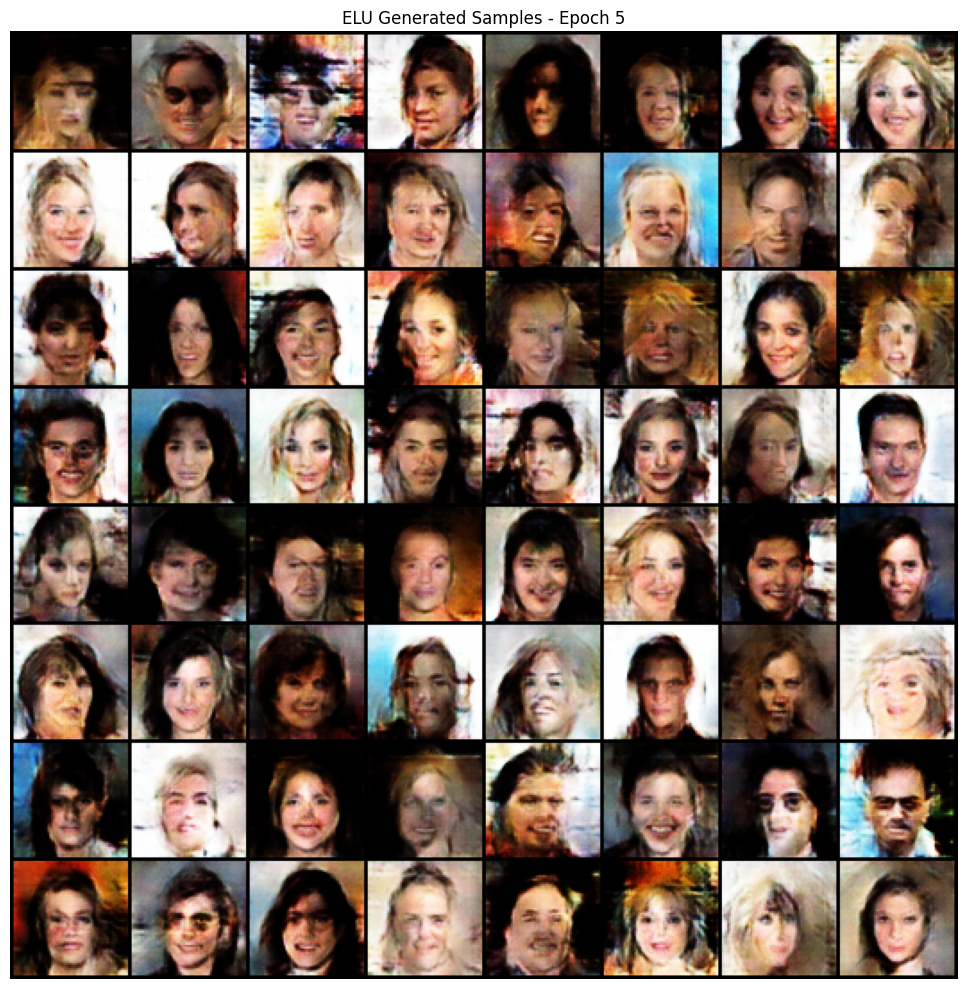

Epoch 6/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   6/25 | G_loss: 3.8190 | D_loss: 0.6738 | Time: 403.3s


Epoch 7/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   7/25 | G_loss: 3.8971 | D_loss: 0.6623 | Time: 470.1s


Epoch 8/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   8/25 | G_loss: 4.0014 | D_loss: 0.6173 | Time: 536.8s


Epoch 9/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch   9/25 | G_loss: 4.1457 | D_loss: 0.5919 | Time: 603.5s


Epoch 10/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  10/25 | G_loss: 4.2320 | D_loss: 0.5654 | Time: 670.4s
Generating samples for epoch 10...


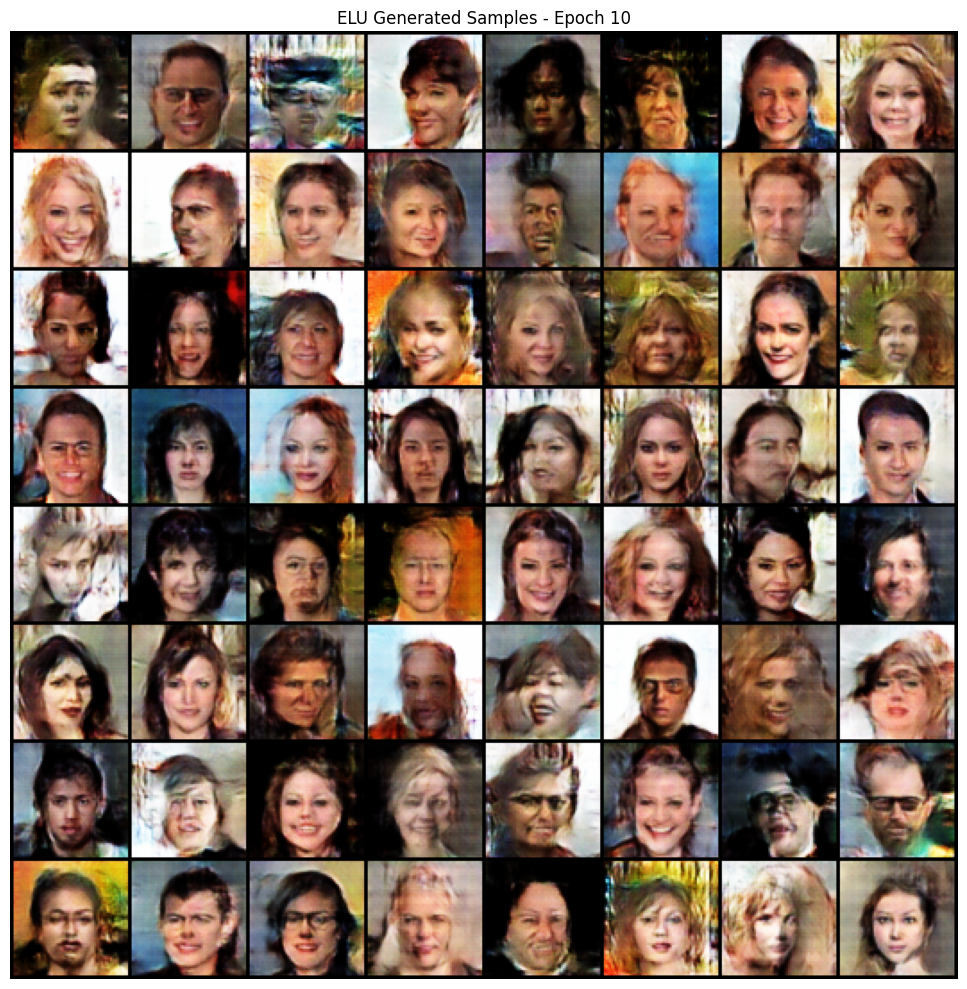

Checkpoint saved: checkpoints/elu_checkpoint_epoch_010.pth


Epoch 11/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  11/25 | G_loss: 4.3585 | D_loss: 0.5587 | Time: 738.2s


Epoch 12/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  12/25 | G_loss: 4.4608 | D_loss: 0.5201 | Time: 804.7s


Epoch 13/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  13/25 | G_loss: 4.5356 | D_loss: 0.5406 | Time: 871.5s


Epoch 14/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  14/25 | G_loss: 4.6080 | D_loss: 0.5028 | Time: 937.9s


Epoch 15/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  15/25 | G_loss: 4.7456 | D_loss: 0.5055 | Time: 1004.6s
Generating samples for epoch 15...


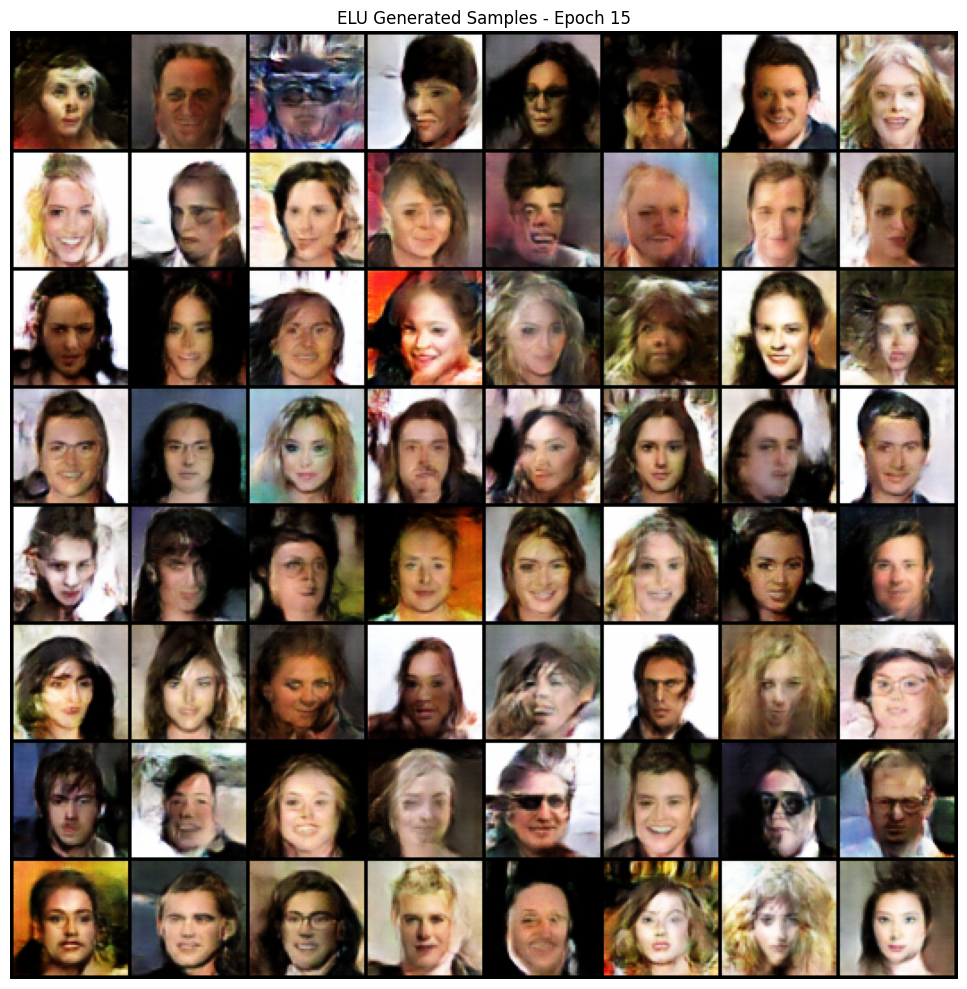

Epoch 16/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  16/25 | G_loss: 4.8402 | D_loss: 0.4820 | Time: 1071.7s


Epoch 17/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  17/25 | G_loss: 4.9276 | D_loss: 0.4673 | Time: 1137.7s


Epoch 18/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  18/25 | G_loss: 5.0204 | D_loss: 0.4653 | Time: 1203.7s


Epoch 19/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  19/25 | G_loss: 5.1637 | D_loss: 0.4478 | Time: 1269.9s


Epoch 20/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  20/25 | G_loss: 5.2741 | D_loss: 0.4278 | Time: 1336.0s
Generating samples for epoch 20...


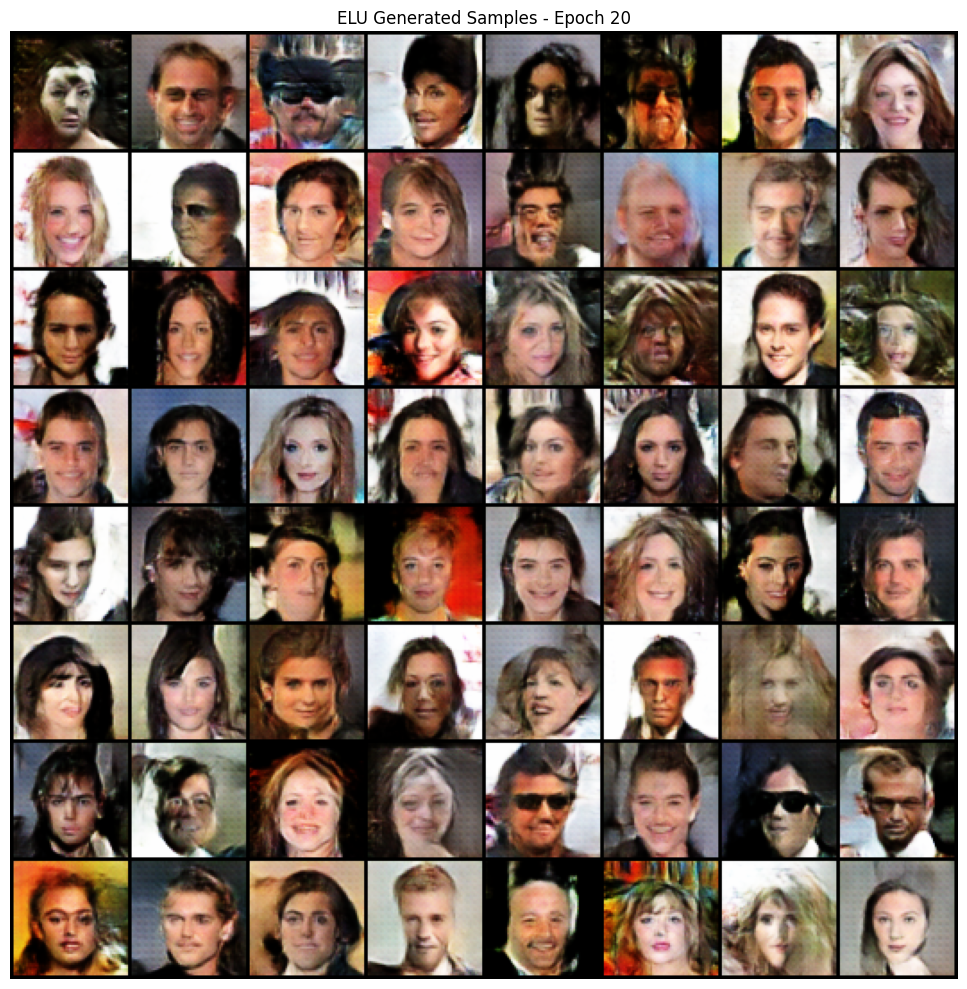

Checkpoint saved: checkpoints/elu_checkpoint_epoch_020.pth


Epoch 21/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  21/25 | G_loss: 5.3799 | D_loss: 0.4252 | Time: 1403.5s


Epoch 22/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  22/25 | G_loss: 5.4277 | D_loss: 0.4113 | Time: 1469.9s


Epoch 23/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  23/25 | G_loss: 5.5589 | D_loss: 0.4052 | Time: 1536.3s


Epoch 24/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  24/25 | G_loss: 5.6429 | D_loss: 0.3878 | Time: 1602.7s


Epoch 25/25:   0%|          | 0/781 [00:00<?, ?it/s]

Epoch  25/25 | G_loss: 5.8022 | D_loss: 0.3880 | Time: 1669.0s
Generating samples for epoch 25...


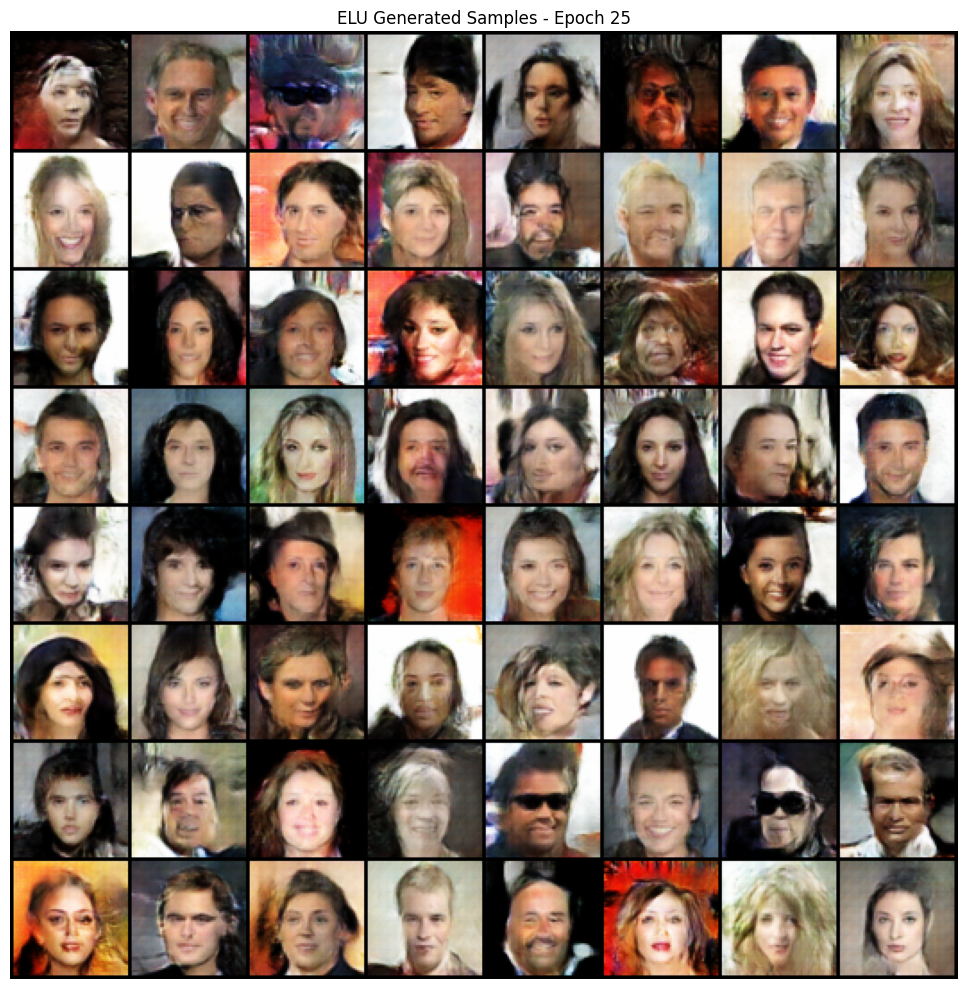


ELU training completed in 1669.8 seconds (27.8 minutes)
Training completed!


TypeError: evaluate_model() takes from 0 to 1 positional arguments but 3 were given

In [ ]:
cfg = {

    "image_size": 64,
    "nc": 3,
    "subset_size": 50000,

    # hyperparameteres
    "nz": 100,
    "ngf": 64,
    "ndf": 64,

    "batch_size": 64,
    "num_epochs": 25,
    "lr_g": 0.0002,
    "lr_d": 0.0003,
    "beta1": 0.0,
    "beta2": 0.9,

    "label_smoothing": 0.1,
    "noise_std": 0.1,

    "sample_every": 5,
    "print_every": 50,
    "device": "cuda" if torch.cuda.is_available() else "cpu",
    "num_workers": 4,
    "sample_dir": "celeba_samples"
}

print("\n" + "="*50)
print("=== ELU EXPERIMENT on CelebA ===")
print("="*50)

G_elu = Generator(cfg["nz"], cfg["ngf"], cfg["nc"], activation='elu').to(device)
D_elu = Discriminator(cfg["nc"], cfg["ndf"]).to(device)

G_elu.apply(weights_init)
D_elu.apply(weights_init)

optimizerG_elu = optim.Adam(G_elu.parameters(), lr=cfg["lr_g"], betas=(cfg["beta1"], cfg["beta2"])) # different variants of this one 
optimizerD_elu = optim.Adam(D_elu.parameters(), lr=cfg["lr_d"], betas=(cfg["beta1"], cfg["beta2"]))
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, cfg["nz"], 1, 1, device=device)
ema_G_elu = EMA(G_elu, decay=0.999)

history_elu = {
   'G_loss': [],
   'D_loss': [],
   'epochs': []
}

Path(cfg["sample_dir"]).mkdir(exist_ok=True)
Path("checkpoints").mkdir(exist_ok=True)

print("Starting training...")
print(f"Total batches per epoch: {len(dataloader)}")
print(f"Device: {device}")

start_time = time.time()

for epoch in range(cfg["num_epochs"]):
   G_elu.train()
   D_elu.train()

   G_losses = []
   D_losses = []

   pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{cfg['num_epochs']}", leave=False)

   for i, (data, _) in enumerate(pbar):

       D_elu.zero_grad()
       real_data = data.to(device)
       batch_size = real_data.size(0)

       # fake
       label = torch.full((batch_size,), 1., dtype=torch.float, device=device)
       output = D_elu(real_data)
       errD_real = criterion(output, label)
       errD_real.backward()

       # fake
       noise = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
       fake = G_elu(noise)
       label.fill_(0.)
       output = D_elu(fake.detach())
       errD_fake = criterion(output, label)
       errD_fake.backward()

       errD = errD_real + errD_fake
       optimizerD_elu.step()
       G_elu.zero_grad()
       label.fill_(1.)
       output = D_elu(fake)
       errG = criterion(output, label)
       errG.backward()
       optimizerG_elu.step()
       ema_G_elu.update()

       G_losses.append(errG.item())
       D_losses.append(errD.item())

       pbar.set_postfix({
           'G_loss': f'{errG.item():.4f}',
           'D_loss': f'{errD.item():.4f}'
       })

   epoch_time = time.time() - start_time
   avg_G_loss = np.mean(G_losses)
   avg_D_loss = np.mean(D_losses)

   history_elu['epochs'].append(epoch + 1)
   history_elu['G_loss'].append(avg_G_loss)
   history_elu['D_loss'].append(avg_D_loss)

   elapsed = time.time() - start_time
   print(f"Epoch {epoch+1:3d}/{cfg['num_epochs']} | G_loss: {avg_G_loss:.4f} | D_loss: {avg_D_loss:.4f} | Time: {elapsed:.1f}s")

   if (epoch + 1) % cfg["sample_every"] == 0:
       print(f"Generating samples for epoch {epoch+1}...")
       save_samples(epoch + 1, G_elu, "elu", fixed_noise, cfg)

   if (epoch + 1) % 10 == 0:
       ema_G_elu.apply_shadow()
       checkpoint = {
           'epoch': epoch + 1,
           'G_state_dict': G_elu.state_dict(),
           'D_state_dict': D_elu.state_dict(),
           'opt_G_state_dict': optimizerG_elu.state_dict(),
           'opt_D_state_dict': optimizerD_elu.state_dict(),
           'ema_shadow': ema_G_elu.shadow,
           'history': history_elu,
           'config': cfg
       }
       #torch.save(checkpoint, f"checkpoints/elu_checkpoint_epoch_{epoch+1:03d}.pth")
       ema_G_elu.restore()
       print(f"Checkpoint saved: checkpoints/elu_checkpoint_epoch_{epoch+1:03d}.pth")

total_time = time.time() - start_time
print(f"\nELU training completed in {total_time:.1f} seconds ({total_time/60:.1f} minutes)")

ema_G_elu.apply_shadow()
final_checkpoint = {
   'epoch': cfg["num_epochs"],
   'G_state_dict': G_elu.state_dict(),
   'D_state_dict': D_elu.state_dict(),
   'ema_shadow': ema_G_elu.shadow,
   'history': history_elu,
   'config': cfg,
   'timestamp': time.strftime("%Y-%m-%d %H:%M:%S"),
   'total_training_time': total_time
}
ema_G_elu.restore()

print("Training completed!")


In [ ]:
!pip install torch-fidelity
from pathlib import Path
import torch
import torch.nn.functional as F
from torchvision.models import inception_v3
import numpy as np
from scipy.stats import entropy

import numpy as np
import torch.serialization
import pickle


# please be good to me......
def evaluate_model(model_type='elu'):
    checkpoints = sorted(Path('checkpoints').glob(f'{model_type}_checkpoint_epoch_*.pth'))

    if not checkpoints:
        print(f"No {model_type.upper()} checkpoints found!")
        return None

    latest_checkpoint = checkpoints[-1]
    print(f"Loading checkpoint: {latest_checkpoint}")

    checkpoint = torch.load(latest_checkpoint, map_location=device, pickle_module=pickle)

    if model_type == 'elu':
        G = Generator(cfg["nz"], cfg["ngf"], cfg["nc"], activation='elu').to(device)
    else:
        G = Generator(cfg["nz"], cfg["ngf"], cfg["nc"], activation='relu').to(device)

    G.load_state_dict(checkpoint['G_state_dict'])

    ema_G = EMA(G, decay=0.999)
    ema_G.shadow = checkpoint['ema_shadow']

    return evaluate_inception_score(G, ema_G, model_type.upper())

In [ ]:
elu_results = evaluate_model('elu')


Loading checkpoint: checkpoints/elu_checkpoint_epoch_020.pth


AttributeError: 'dict' object has no attribute 'eval'

Radford, A., Metz, L., & Chintala, S. (2015). Unsupervised representation learning with deep convolutional generative adversarial networks. arXiv preprint arXiv:1511.06434.